In [3]:
pip install xgboost

     -------------------------------------- 124.9/124.9 MB 7.0 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, ShuffleSplit, learning_curve, StratifiedKFold, cross_val_score
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_curve, roc_auc_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.impute import SimpleImputer
import pandas as pd
import re
import seaborn as sns
from scipy import stats
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from xgboost import XGBRegressor
from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import RandomizedSearchCV

In [2]:
df = pd.read_csv("D:/Swinburne/Sem 3/Big Data/HD/apm_point_sold_nsw.csv")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1140979 entries, 0 to 1140978
Data columns (total 65 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   FID                        1140979 non-null  object 
 1   propertycategorisation     1140979 non-null  object 
 2   streetname                 1140885 non-null  object 
 3   streettype                 1129977 non-null  object 
 4   suburb                     1140979 non-null  object 
 5   postcode                   1140979 non-null  int64  
 6   state                      1140979 non-null  object 
 7   sa1code                    1019459 non-null  float64
 8   eventdate                  1140979 non-null  object 
 9   eventprice                 1111823 non-null  float64
 10  eventtypecode              1140979 non-null  object 
 11  firstadvertisedeventdate   885428 non-null   object 
 12  firstadvertisedeventprice  542927 non-null   float64
 13  lastadvertis

In [4]:
# Display the names of all columns
print("Column Names:")
print(df.columns)

# Display data types of each column
print("\nData Types of Columns:")
print(df.dtypes)

# Display a summary of non-null counts and data types
print("\nInfo Summary:")
print(df.info())

# Display the first few rows to get a sense of the data in each column
print("\nFirst Few Rows of the Dataset:")
print(df.head())

# Display the unique values and their counts for categorical columns
categorical_cols = df.select_dtypes(include=['object']).columns
for col in categorical_cols:
    print(f"\nUnique Values in '{col}':")
    print(df[col].value_counts())

# Display basic statistics for numerical columns
print("\nDescriptive Statistics for Numerical Columns:")
print(df.describe())

Column Names:
Index(['FID', 'propertycategorisation', 'streetname', 'streettype', 'suburb',
       'postcode', 'state', 'sa1code', 'eventdate', 'eventprice',
       'eventtypecode', 'firstadvertisedeventdate',
       'firstadvertisedeventprice', 'lastadvertisedeventdate',
       'lastadvertisedeventprice', 'finalresulteventdate',
       'finalresulteventprice', 'finalresulteventtypecode', 'propertytype',
       'areasize', 'bedrooms', 'baths', 'parking', 'hasstudy',
       'hasseparatedining', 'hasfamilyroom', 'hassunroom', 'hasbilliardroom',
       'hasrumpusroom', 'hasfireplace', 'haswalkinwardrobe', 'hascourtyard',
       'hasinternallaundry', 'hasheating', 'hassauna', 'hasairconditioning',
       'hasbalcony', 'hasbarbeque', 'haspolishedtimberfloor', 'hasensuite',
       'hasspa', 'hasgarage', 'haslockupgarage', 'haspool', 'hastenniscourt',
       'hasbeenrenovated', 'hasalarm', 'haswaterview', 'hasharbourview',
       'hasoceanview', 'hascityview', 'hasbushview', 'hasdistrictview'

# Pre-processing

In [5]:
df.head()

,FID,propertycategorisation,streetname,streettype,suburb,postcode,state,sa1code,eventdate,eventprice,...,hasriverview,hasmountainview,advertlinkexternalid,property_latitude,property_longitude,street_centroid_latitude,street_centroid_longitude,month,year,the_geom
0,apm_point_sold_nsw.374101,House,Federation,Dr,Medowie,2318,NSW,1.060311e+10,2021-05-28,950000.0,...,NaN,NaN,2.016998e+09,-32.73393,151.87674,-32.73197,151.87641,5,2021,POINT (-32.73393 151.87674)
1,apm_point_sold_nsw.374102,House,Koel,Pl,Woronora Heights,2233,NSW,1.280216e+10,2019-05-08,1050100.0,...,NaN,NaN,NaN,-34.03078,151.02859,-34.03108,151.02864,5,2019,POINT (-34.03078 151.02859)
2,apm_point_sold_nsw.374103,House,Stanley,St,Mona Vale,2103,NSW,1.220214e+10,2020-08-21,3000000.0,...,NaN,NaN,2.016396e+09,-33.67632,151.31369,-33.67584,151.31403,8,2020,POINT (-33.67632 151.31369)
3,apm_point_sold_nsw.374104,House,Peter,Cr,Greenacre,2190,NSW,1.190114e+10,2022-05-07,1330000.0,...,NaN,NaN,2.017728e+09,-33.89731,151.05179,-33.89696,151.05268,5,2022,POINT (-33.89731 151.05179)
4,apm_point_sold_nsw.374105,House,Babbin,Pl,Caringbah South,2229,NSW,1.280116e+10,2023-10-27,2245000.0,...,NaN,NaN,2.018629e+09,-34.04770,151.11682,-34.04781,151.11606,10,2023,POINT (-34.0477 151.11682)


In [6]:
df.describe()

,postcode,sa1code,eventprice,firstadvertisedeventprice,lastadvertisedeventprice,finalresulteventprice,areasize,bedrooms,baths,parking,...,hasparkview,hasriverview,hasmountainview,advertlinkexternalid,property_latitude,property_longitude,street_centroid_latitude,street_centroid_longitude,month,year
count,1.140979e+06,1.019459e+06,1.111823e+06,5.429270e+05,6.253170e+05,1.128291e+06,1.108638e+06,927430.000000,888670.000000,887961.000000,...,0.0,0.0,0.0,9.619840e+05,1.111457e+06,1.111457e+06,1.133509e+06,1.133509e+06,1.140979e+06,1.140979e+06
mean,2.321050e+03,1.157394e+10,1.131238e+06,9.104721e+05,8.995034e+05,1.127100e+06,5.609188e+03,3.175801,1.757097,1.733511,...,NaN,NaN,NaN,1.904397e+09,-3.348589e+01,1.509859e+02,-3.349004e+01,1.509864e+02,6.562094e+00,2.021192e+03
std,2.412932e+02,7.880421e+08,2.178570e+06,5.274477e+06,3.695883e+06,1.823696e+06,1.495246e+06,1.133642,0.771326,1.093473,...,NaN,NaN,NaN,4.607707e+08,1.338444e+00,1.216910e+00,1.331924e+00,1.209980e+00,3.400298e+00,1.490047e+00
min,2.000000e+03,1.010210e+10,0.000000e+00,1.000000e+01,1.000000e+01,0.000000e+00,1.000000e+00,1.000000,1.000000,0.000000,...,NaN,NaN,NaN,8.312490e+05,-3.725666e+01,1.412155e+02,-3.725511e+01,1.411078e+02,1.000000e+00,2.019000e+03
25%,2.130000e+03,1.090312e+10,5.600000e+05,5.236880e+05,5.290000e+05,5.590000e+05,4.430000e+02,2.000000,1.000000,1.000000,...,NaN,NaN,NaN,2.015695e+09,-3.393300e+01,1.508719e+02,-3.393406e+01,1.508692e+02,3.000000e+00,2.020000e+03
50%,2.251000e+03,1.170313e+10,7.911000e+05,7.000000e+05,7.100000e+05,7.900000e+05,6.640000e+02,3.000000,2.000000,2.000000,...,NaN,NaN,NaN,2.016988e+09,-3.381163e+01,1.510985e+02,-3.381207e+01,1.510980e+02,7.000000e+00,2.021000e+03
75%,2.527000e+03,1.220214e+10,1.240000e+06,9.500000e+05,9.600000e+05,1.245000e+06,1.041000e+03,4.000000,2.000000,2.000000,...,NaN,NaN,NaN,2.018063e+09,-3.343032e+01,1.512698e+02,-3.343280e+01,1.512680e+02,1.000000e+01,2.022000e+03
max,4.383000e+03,1.280216e+10,1.012500e+09,2.147484e+09,1.900000e+09,1.723654e+08,1.304260e+09,32.000000,20.000000,70.000000,...,NaN,NaN,NaN,2.019327e+09,-2.816608e+01,1.536366e+02,-2.816663e+01,1.536349e+02,1.200000e+01,2.024000e+03


In [7]:
# List of columns with no values
columns_with_no_values = [
    'hasbilliardroom', 'hassauna', 'hasbeenrenovated',
    'haswaterview', 'hasharbourview', 'hasoceanview',
    'hascityview', 'hasbushview', 'hasdistrictview',
    'hasbayview', 'hasparkview', 'hasriverview',
    'hasmountainview'
]

# Drop columns with no values
df.drop(columns=columns_with_no_values, inplace=True)

# List of columns with very high missing values
columns_with_high_missing_values = [
    'hasstudy', 'hasseparatedining', 'hasfamilyroom', 
    'hassunroom', 'hasrumpusroom', 'hasfireplace', 
    'haswalkinwardrobe', 'hascourtyard', 'hasinternallaundry', 
    'hasheating', 'hasairconditioning', 'hasbalcony', 
    'hasbarbeque', 'haspolishedtimberfloor', 'hasensuite', 
    'hasspa', 'hasgarage', 'haslockupgarage', 
    'haspool', 'hastenniscourt', 'hasalarm'
]

# Replace missing values with 0
df[columns_with_high_missing_values] = df[columns_with_high_missing_values].fillna(False)

# Save the cleaned DataFrame to a new CSV file
df.to_csv('cleaned_data.csv', index=False)

In [8]:
# List all columns and the number of missing values in each column
missing_values = df.isnull().sum()
missing_values = missing_values[missing_values > 0]

# Display the columns with their number of missing values
print("Columns with missing values and the number of missing values:")
print(missing_values)

Columns with missing values and the number of missing values:
streetname                       94
streettype                    11002
sa1code                      121520
eventprice                    29156
firstadvertisedeventdate     255551
firstadvertisedeventprice    598052
lastadvertisedeventdate      255551
lastadvertisedeventprice     515662
finalresulteventdate             35
finalresulteventprice         12688
finalresulteventtypecode         72
areasize                      32341
bedrooms                     213549
baths                        252309
parking                      253018
advertlinkexternalid         178995
property_latitude             29522
property_longitude            29522
street_centroid_latitude       7470
street_centroid_longitude      7470
the_geom                      29522
dtype: int64


In [9]:
# Calculate the threshold for 70% missing data
threshold = 0.7 * len(df)

# Filter columns with missing values exceeding the threshold
df = df.loc[:, df.isnull().sum() < threshold]

# Save the cleaned DataFrame
df.to_csv('cleaned_data.csv', index=False)  # Save the cleaned DataFrame

In [10]:
# List all columns and the number of missing values in each column
missing_values = df.isnull().sum()
missing_values = missing_values[missing_values > 0]

# Display the columns with their number of missing values
print("Columns with missing values and the number of missing values:")
print(missing_values)

Columns with missing values and the number of missing values:
streetname                       94
streettype                    11002
sa1code                      121520
eventprice                    29156
firstadvertisedeventdate     255551
firstadvertisedeventprice    598052
lastadvertisedeventdate      255551
lastadvertisedeventprice     515662
finalresulteventdate             35
finalresulteventprice         12688
finalresulteventtypecode         72
areasize                      32341
bedrooms                     213549
baths                        252309
parking                      253018
advertlinkexternalid         178995
property_latitude             29522
property_longitude            29522
street_centroid_latitude       7470
street_centroid_longitude      7470
the_geom                      29522
dtype: int64


In [11]:
df.head()

,FID,propertycategorisation,streetname,streettype,suburb,postcode,state,sa1code,eventdate,eventprice,...,hastenniscourt,hasalarm,advertlinkexternalid,property_latitude,property_longitude,street_centroid_latitude,street_centroid_longitude,month,year,the_geom
0,apm_point_sold_nsw.374101,House,Federation,Dr,Medowie,2318,NSW,1.060311e+10,2021-05-28,950000.0,...,False,False,2.016998e+09,-32.73393,151.87674,-32.73197,151.87641,5,2021,POINT (-32.73393 151.87674)
1,apm_point_sold_nsw.374102,House,Koel,Pl,Woronora Heights,2233,NSW,1.280216e+10,2019-05-08,1050100.0,...,False,False,NaN,-34.03078,151.02859,-34.03108,151.02864,5,2019,POINT (-34.03078 151.02859)
2,apm_point_sold_nsw.374103,House,Stanley,St,Mona Vale,2103,NSW,1.220214e+10,2020-08-21,3000000.0,...,False,False,2.016396e+09,-33.67632,151.31369,-33.67584,151.31403,8,2020,POINT (-33.67632 151.31369)
3,apm_point_sold_nsw.374104,House,Peter,Cr,Greenacre,2190,NSW,1.190114e+10,2022-05-07,1330000.0,...,False,False,2.017728e+09,-33.89731,151.05179,-33.89696,151.05268,5,2022,POINT (-33.89731 151.05179)
4,apm_point_sold_nsw.374105,House,Babbin,Pl,Caringbah South,2229,NSW,1.280116e+10,2023-10-27,2245000.0,...,False,True,2.018629e+09,-34.04770,151.11682,-34.04781,151.11606,10,2023,POINT (-34.0477 151.11682)


In [12]:
# Function to update the_geom based on property_latitude and property_longitude or vice versa
def update_geom(row):
    # If the_geom is missing but latitude and longitude are present
    if pd.isnull(row['the_geom']) and pd.notnull(row['property_latitude']) and pd.notnull(row['property_longitude']):
        return f"POINT ({row['property_longitude']} {row['property_latitude']})"
    # If latitude and longitude are missing but the_geom has value
    elif pd.notnull(row['the_geom']):
        # Extract latitude and longitude from the_geom
        match = re.match(r"POINT \(([-\d.]+) ([-\d.]+)\)", row['the_geom'])
        if match:
            row['property_longitude'], row['property_latitude'] = map(float, match.groups())
        return row['the_geom']
    else:
        return None

# Apply the function to update 'the_geom' column and extract latitude and longitude if missing
df['the_geom'] = df.apply(update_geom, axis=1)

# Drop rows where both the_geom and latitude/longitude are missing
df = df.dropna(subset=['the_geom', 'property_latitude', 'property_longitude'], how='all')

In [13]:
# Display the updated DataFrame
df.head()

,FID,propertycategorisation,streetname,streettype,suburb,postcode,state,sa1code,eventdate,eventprice,...,hastenniscourt,hasalarm,advertlinkexternalid,property_latitude,property_longitude,street_centroid_latitude,street_centroid_longitude,month,year,the_geom
0,apm_point_sold_nsw.374101,House,Federation,Dr,Medowie,2318,NSW,1.060311e+10,2021-05-28,950000.0,...,False,False,2.016998e+09,-32.73393,151.87674,-32.73197,151.87641,5,2021,POINT (-32.73393 151.87674)
1,apm_point_sold_nsw.374102,House,Koel,Pl,Woronora Heights,2233,NSW,1.280216e+10,2019-05-08,1050100.0,...,False,False,NaN,-34.03078,151.02859,-34.03108,151.02864,5,2019,POINT (-34.03078 151.02859)
2,apm_point_sold_nsw.374103,House,Stanley,St,Mona Vale,2103,NSW,1.220214e+10,2020-08-21,3000000.0,...,False,False,2.016396e+09,-33.67632,151.31369,-33.67584,151.31403,8,2020,POINT (-33.67632 151.31369)
3,apm_point_sold_nsw.374104,House,Peter,Cr,Greenacre,2190,NSW,1.190114e+10,2022-05-07,1330000.0,...,False,False,2.017728e+09,-33.89731,151.05179,-33.89696,151.05268,5,2022,POINT (-33.89731 151.05179)
4,apm_point_sold_nsw.374105,House,Babbin,Pl,Caringbah South,2229,NSW,1.280116e+10,2023-10-27,2245000.0,...,False,True,2.018629e+09,-34.04770,151.11682,-34.04781,151.11606,10,2023,POINT (-34.0477 151.11682)


In [14]:
# List all columns and the number of missing values in each column
missing_values = df.isnull().sum()
missing_values = missing_values[missing_values > 0]

# Display the columns with their number of missing values
print("Columns with missing values and the number of missing values:")
print(missing_values)

Columns with missing values and the number of missing values:
streetname                       88
streettype                     9811
sa1code                       92091
eventprice                    18741
firstadvertisedeventdate     246159
firstadvertisedeventprice    585357
lastadvertisedeventdate      246159
lastadvertisedeventprice     503555
finalresulteventdate             32
finalresulteventprice          2424
finalresulteventtypecode         69
areasize                      23010
bedrooms                     207325
baths                        243932
parking                      244650
advertlinkexternalid         169884
street_centroid_latitude         81
street_centroid_longitude        81
dtype: int64


In [15]:
# Replace missing 'eventprice' values with 'lastadvertisedeventprice' where available
df['eventprice'] = df['eventprice'].fillna(df['lastadvertisedeventprice'])

# Drop rows where 'eventprice' is missing
df = df.dropna(subset=['eventprice'])

# Optional: Reset index after dropping rows
df.reset_index(drop=True, inplace=True)

In [16]:
# List all columns and the number of missing values in each column
missing_values = df.isnull().sum()
missing_values = missing_values[missing_values > 0]

# Display the columns with their number of missing values
print("Columns with missing values and the number of missing values:")
print(missing_values)

Columns with missing values and the number of missing values:
streetname                       88
streettype                     9706
sa1code                       91754
firstadvertisedeventdate     245190
firstadvertisedeventprice    575093
lastadvertisedeventdate      245190
lastadvertisedeventprice     491201
finalresulteventdate             32
finalresulteventprice          1045
finalresulteventtypecode         68
areasize                      22897
bedrooms                     207279
baths                        243202
parking                      243921
advertlinkexternalid         169427
street_centroid_latitude         81
street_centroid_longitude        81
dtype: int64


In [17]:
# Replace missing 'bedrooms' and 'baths' with 0 where 'propertytype' is 'Studio'
df.loc[(df['propertytype'] == 'Studio') & (df['bedrooms'].isnull()), 'bedrooms'] = 0
df.loc[(df['propertytype'] == 'Studio') & (df['baths'].isnull()), 'baths'] = 1

In [18]:
# List all columns and the number of missing values in each column
missing_values = df.isnull().sum()
missing_values = missing_values[missing_values > 0]

# Display the columns with their number of missing values
print("Columns with missing values and the number of missing values:")
print(missing_values)

Columns with missing values and the number of missing values:
streetname                       88
streettype                     9706
sa1code                       91754
firstadvertisedeventdate     245190
firstadvertisedeventprice    575093
lastadvertisedeventdate      245190
lastadvertisedeventprice     491201
finalresulteventdate             32
finalresulteventprice          1045
finalresulteventtypecode         68
areasize                      22897
bedrooms                     205372
baths                        242719
parking                      243921
advertlinkexternalid         169427
street_centroid_latitude         81
street_centroid_longitude        81
dtype: int64


In [19]:
# Fill missing values for categorical columns
df['streetname'].fillna('Unknown', inplace=True)
df['streettype'].fillna('Unknown', inplace=True)
df['finalresulteventtypecode'].fillna('Unknown', inplace=True)

# Fill missing values for numerical columns with median or mean
df['sa1code'].fillna(df['sa1code'].median(), inplace=True)
df['firstadvertisedeventdate'].fillna(df['firstadvertisedeventdate'].mode()[0], inplace=True)
df['firstadvertisedeventprice'].fillna(df['firstadvertisedeventprice'].median(), inplace=True)
df['lastadvertisedeventdate'].fillna(df['lastadvertisedeventdate'].mode()[0], inplace=True)
df['lastadvertisedeventprice'].fillna(df['lastadvertisedeventprice'].median(), inplace=True)
df['finalresulteventdate'].fillna(df['finalresulteventdate'].mode()[0], inplace=True)
df['finalresulteventprice'].fillna(df['finalresulteventprice'].median(), inplace=True)
df['areasize'].fillna(df['areasize'].median(), inplace=True)
df['bedrooms'].fillna(0, inplace=True)
df['baths'].fillna(0, inplace=True)
df['parking'].fillna(0, inplace=True)
df['advertlinkexternalid'].fillna(df['advertlinkexternalid'].mode()[0], inplace=True)
df['street_centroid_latitude'].fillna(df['street_centroid_latitude'].median(), inplace=True)
df['street_centroid_longitude'].fillna(df['street_centroid_longitude'].median(), inplace=True)

# Drop columns with too many missing values
columns_to_drop = ['firstadvertisedeventdate', 'lastadvertisedeventdate']
df.drop(columns=columns_to_drop, inplace=True)

# Drop rows with critical missing values if necessary
df.dropna(subset=['eventprice'], inplace=True)

# Verify if there are any remaining missing values
missing_values = df.isnull().sum()
print(missing_values[missing_values > 0])

Series([], dtype: int64)


In [20]:
missing_values

FID                          0
propertycategorisation       0
streetname                   0
streettype                   0
suburb                       0
postcode                     0
state                        0
sa1code                      0
eventdate                    0
eventprice                   0
eventtypecode                0
firstadvertisedeventprice    0
lastadvertisedeventprice     0
finalresulteventdate         0
finalresulteventprice        0
finalresulteventtypecode     0
propertytype                 0
areasize                     0
bedrooms                     0
baths                        0
parking                      0
hasstudy                     0
hasseparatedining            0
hasfamilyroom                0
hassunroom                   0
hasrumpusroom                0
hasfireplace                 0
haswalkinwardrobe            0
hascourtyard                 0
hasinternallaundry           0
hasheating                   0
hasairconditioning           0
hasbalco

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1099103 entries, 0 to 1099102
Data columns (total 50 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   FID                        1099103 non-null  object 
 1   propertycategorisation     1099103 non-null  object 
 2   streetname                 1099103 non-null  object 
 3   streettype                 1099103 non-null  object 
 4   suburb                     1099103 non-null  object 
 5   postcode                   1099103 non-null  int64  
 6   state                      1099103 non-null  object 
 7   sa1code                    1099103 non-null  float64
 8   eventdate                  1099103 non-null  object 
 9   eventprice                 1099103 non-null  float64
 10  eventtypecode              1099103 non-null  object 
 11  firstadvertisedeventprice  1099103 non-null  float64
 12  lastadvertisedeventprice   1099103 non-null  float64
 13  finalresulte

## Data Cleaning Process

### 1. Initial Dataset Overview
- The dataset initially contained 1,140,979 entries and 65 columns with various data types.
- Many columns had missing values and required cleaning to ensure data integrity.

### 2. Dropping Columns with No Values
- Identified columns with no values at all, which were irrelevant to the analysis.
- Removed these columns to reduce clutter and focus on meaningful data.

### 3. Handling Columns with High Missing Values
- Listed columns with a high proportion of missing values.
- For these columns, missing values were replaced with a default value (0) to maintain dataset consistency.

### 4. Removing Columns with Excessive Missing Values
- Calculated a threshold for columns with more than 70% missing values.
- Removed columns that exceeded this threshold to retain only those with sufficient data for analysis.

### 5. Updating `the_geom` Column
- Defined a function to update the `the_geom` column based on available latitude and longitude values.
- Extracted latitude and longitude from `the_geom` when necessary to ensure accurate geospatial information.

### 6. Removing Rows with Missing Geospatial Data
- Removed rows where both `the_geom` and latitude/longitude values were missing.
- Ensured that all remaining data had complete geospatial information for accurate spatial analysis.

### 7. Replacing Missing Event Prices
- For rows where `eventprice` was missing but `lastadvertisedeventprice` was available, replaced `eventprice` with `lastadvertisedeventprice`.
- Dropped columns with no `eventprice` values to focus on complete data.

### 8. Handling Missing Values for Specific Property Types
- Identified rows where the `propertytype` was 'Studio' and both `bedrooms` and `baths` were missing.
- Replaced missing values for `bedrooms` with 0 and `baths` with 1 to ensure all properties had complete information.

### 9. Final Cleaning for Missing Values
- Reviewed and cleaned any remaining columns with missing values:
  - Replaced missing values in `streetname`, `streettype`, `sa1code`, `firstadvertisedeventdate`, `firstadvertisedeventprice`, `lastadvertisedeventdate`, `lastadvertisedeventprice`, `finalresulteventdate`, `finalresulteventprice`, `finalresulteventtypecode`, `areasize`, `bedrooms`, `baths`, `parking`, `advertlinkexternalid`, `street_centroid_latitude`, and `street_centroid_longitude`.
- Ensured no missing values remained in the dataset.

### 10. Saving the Cleaned DataFrame
- The final cleaned DataFrame, which now contained 1,099,102 entries, was saved to a new CSV file for further analysis.

---

This detailed markdown outlines the comprehensive steps taken to clean and prepare the dataset, ensuring it is ready for meaningful analysis.

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1099103 entries, 0 to 1099102
Data columns (total 50 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   FID                        1099103 non-null  object 
 1   propertycategorisation     1099103 non-null  object 
 2   streetname                 1099103 non-null  object 
 3   streettype                 1099103 non-null  object 
 4   suburb                     1099103 non-null  object 
 5   postcode                   1099103 non-null  int64  
 6   state                      1099103 non-null  object 
 7   sa1code                    1099103 non-null  float64
 8   eventdate                  1099103 non-null  object 
 9   eventprice                 1099103 non-null  float64
 10  eventtypecode              1099103 non-null  object 
 11  firstadvertisedeventprice  1099103 non-null  float64
 12  lastadvertisedeventprice   1099103 non-null  float64
 13  finalresulte

# EDA

In [23]:
# Display basic information about the dataset
print("Dataset Information:")
print(df.info())


Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1099103 entries, 0 to 1099102
Data columns (total 50 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   FID                        1099103 non-null  object 
 1   propertycategorisation     1099103 non-null  object 
 2   streetname                 1099103 non-null  object 
 3   streettype                 1099103 non-null  object 
 4   suburb                     1099103 non-null  object 
 5   postcode                   1099103 non-null  int64  
 6   state                      1099103 non-null  object 
 7   sa1code                    1099103 non-null  float64
 8   eventdate                  1099103 non-null  object 
 9   eventprice                 1099103 non-null  float64
 10  eventtypecode              1099103 non-null  object 
 11  firstadvertisedeventprice  1099103 non-null  float64
 12  lastadvertisedeventprice   1099103 non-null  floa

In [24]:
# Display basic statistics of numerical columns
print("\nDescriptive Statistics:")
print(df.describe())


Descriptive Statistics:
           postcode       sa1code    eventprice  firstadvertisedeventprice  \
count  1.099103e+06  1.099103e+06  1.099103e+06               1.099103e+06   
mean   2.320733e+03  1.158170e+10  1.130743e+06               7.991999e+05   
std    2.404179e+02  7.563350e+08  2.179178e+06               3.706979e+06   
min    2.000000e+03  1.010210e+10  0.000000e+00               1.000000e+01   
25%    2.130000e+03  1.100412e+10  5.600000e+05               7.000000e+05   
50%    2.251000e+03  1.170313e+10  7.930160e+05               7.000000e+05   
75%    2.526000e+03  1.210414e+10  1.240000e+06               7.000000e+05   
max    4.383000e+03  1.280216e+10  1.012500e+09               2.147484e+09   

       lastadvertisedeventprice  finalresulteventprice      areasize  \
count              1.099103e+06           1.099103e+06  1.099103e+06   
mean               8.094227e+05           1.120135e+06  5.223943e+03   
std                2.631005e+06           1.824313e+06  

In [25]:
# Display the first few rows of the dataset
print("\nFirst Few Rows:")
print(df.head())



First Few Rows:
                         FID propertycategorisation  streetname streettype  \
0  apm_point_sold_nsw.374101                  House  Federation         Dr   
1  apm_point_sold_nsw.374102                  House        Koel         Pl   
2  apm_point_sold_nsw.374103                  House     Stanley         St   
3  apm_point_sold_nsw.374104                  House       Peter         Cr   
4  apm_point_sold_nsw.374105                  House      Babbin        Pl    

             suburb  postcode state       sa1code   eventdate  eventprice  \
0           Medowie      2318   NSW  1.060311e+10  2021-05-28    950000.0   
1  Woronora Heights      2233   NSW  1.280216e+10  2019-05-08   1050100.0   
2         Mona Vale      2103   NSW  1.220214e+10  2020-08-21   3000000.0   
3         Greenacre      2190   NSW  1.190114e+10  2022-05-07   1330000.0   
4   Caringbah South      2229   NSW  1.280116e+10  2023-10-27   2245000.0   

   ... hastenniscourt  hasalarm  advertlinkexternal

In [26]:
# Check for duplicate rows
print("\nNumber of Duplicate Rows:")
print(df.duplicated().sum())


Number of Duplicate Rows:
0


In [27]:
# Distribution of categorical variables
categorical_cols = df.select_dtypes(include=['object']).columns
for col in categorical_cols:
    print(f"\n{col} Distribution:")
    print(df[col].value_counts())


FID Distribution:
apm_point_sold_nsw.374101     1
apm_point_sold_nsw.1135957    1
apm_point_sold_nsw.1135943    1
apm_point_sold_nsw.1135944    1
apm_point_sold_nsw.1135945    1
                             ..
apm_point_sold_nsw.754959     1
apm_point_sold_nsw.754960     1
apm_point_sold_nsw.754961     1
apm_point_sold_nsw.754962     1
apm_point_sold_nsw.374100     1
Name: FID, Length: 1099103, dtype: int64

propertycategorisation Distribution:
House    751553
Unit     347550
Name: propertycategorisation, dtype: int64

streetname Distribution:
Pacific            7580
Victoria           5347
George             4268
Park               4023
Railway            3539
                   ... 
Marabunga             1
Charkers              1
Thomas Hennessy       1
Barrys                1
Haverty               1
Name: streetname, Length: 26704, dtype: int64

streettype Distribution:
St           443298
Rd           197762
Av           138892
Dr            65557
Pl            49810
             

In [28]:
# Reset index to ensure alignment
df.reset_index(drop=True, inplace=True)

# Calculate Z-scores for numerical columns
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
df_numerical = df[numerical_cols]
z_scores = pd.DataFrame(stats.zscore(df_numerical, nan_policy='omit'), columns=numerical_cols)

# Ensure the Z-scores DataFrame has the same index as the original DataFrame
z_scores.index = df_numerical.index

# Define a threshold for identifying outliers
threshold = 3

# Identify outliers (convert to boolean)
outliers = (z_scores.abs() > threshold).any(axis=1)
outliers = outliers.astype(bool)  # Ensure outliers is a boolean Series

# Align the boolean Series with the original DataFrame
outliers_indexed = pd.Series(outliers, index=df.index)

# Remove outliers from the DataFrame
df_no_outliers = df[~outliers_indexed]

# Save the DataFrame without outliers
df_no_outliers.to_csv('cleaned_data_no_outliers.csv', index=False)

In [29]:
df = df_no_outliers

In [30]:
# Display unique values and counts in 'propertytype'
propertytype_counts = df['propertytype'].value_counts()
print("Unique Values in 'propertytype':")
print(propertytype_counts)

# Define a threshold for rare property types
# For example, consider property types with fewer than 1000 occurrences as outliers
threshold = 1000

# Identify rare property types
rare_property_types = propertytype_counts[propertytype_counts < threshold].index

# Remove rows with rare property types
df_cleaned_propertytype = df[~df['propertytype'].isin(rare_property_types)]

# Save the cleaned DataFrame
df_cleaned_propertytype.to_csv('cleaned_data_no_rare_propertytypes.csv', index=False)

print("Rows with rare property types have been removed.")

Unique Values in 'propertytype':
House        569371
Unit         295999
Townhouse     67066
Semi           6881
Duplex         6579
Villa          3716
Studio         2249
Cottage        1903
Terrace        1755
Flat             33
Triplex           2
Name: propertytype, dtype: int64
Rows with rare property types have been removed.


In [35]:
pip install folium

     -------------------------------------- 108.4/108.4 kB 6.1 MB/s eta 0:00:00
     ---------------------------------------- 83.9/83.9 kB 4.6 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [38]:
import folium
from folium.plugins import HeatMap

In [39]:
# Ensure longitude and latitude columns are present
if 'property_longitude' in df.columns and 'property_latitude' in df.columns:
    
    # Create a base map centered around the average latitude and longitude
    center_lat = df['property_latitude'].mean()
    center_lon = df['property_longitude'].mean()
    base_map = folium.Map(location=[center_lat, center_lon], zoom_start=12)

    # Add a heatmap layer
    heat_data = [[row['property_latitude'], row['property_longitude']] for index, row in df.iterrows() if pd.notnull(row['property_latitude']) and pd.notnull(row['property_longitude'])]
    HeatMap(heat_data).add_to(base_map)

    # Save the map to an HTML file
    base_map.save('property_distribution_map.html')

    print("Map has been saved to 'property_distribution_map.html'.")
else:
    print("Longitude and/or latitude columns are missing from the dataset.")

Map has been saved to 'property_distribution_map.html'.


In [40]:
display(base_map)

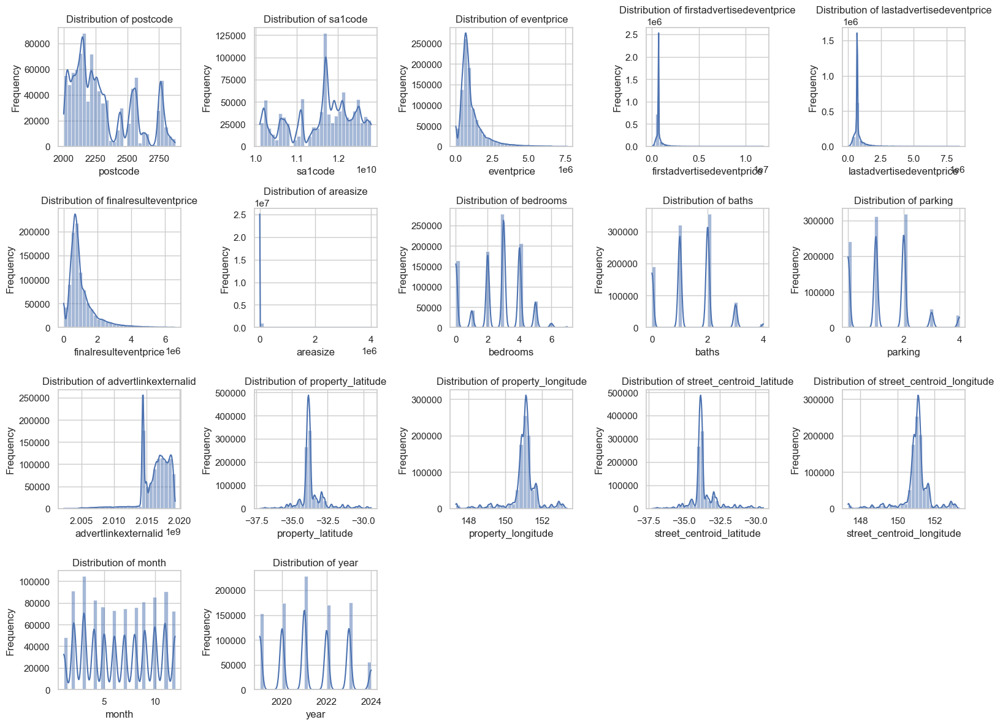

In [41]:
# Set up the visualisation settings
sns.set(style="whitegrid")

# 1. Distribution of Numerical Variables
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns

plt.figure(figsize=(16, 12))
for i, col in enumerate(numerical_cols, 1):
    plt.subplot(4, 5, i)  # Adjust subplot grid size based on the number of numerical columns
    sns.histplot(df[col], kde=True, bins=30)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

In [ ]:
# 2. Boxplots to Identify Outliers
plt.figure(figsize=(16, 12))
for i, col in enumerate(numerical_cols, 1):
    plt.subplot(4, 5, i)  # Adjust subplot grid size based on the number of numerical columns
    sns.boxplot(df[col])
    plt.title(f'Boxplot of {col}')
    plt.xlabel(col)
plt.tight_layout()
plt.show()

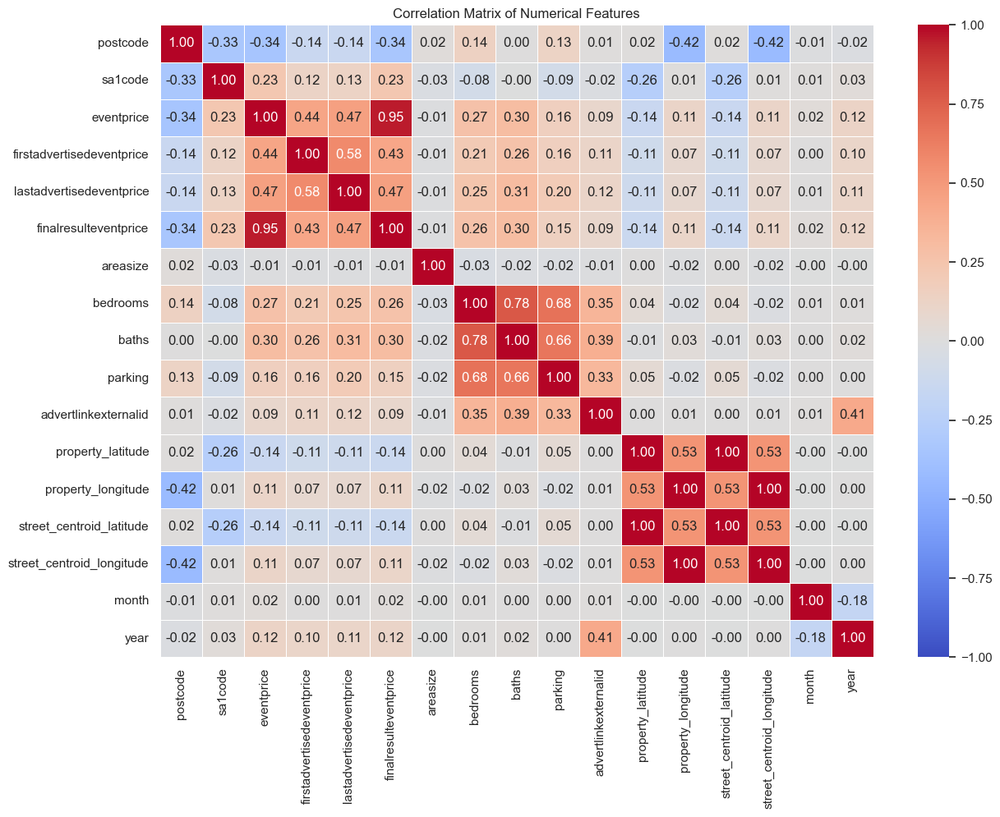

In [42]:
# 4. Correlation Matrix
correlation_matrix = df[numerical_cols].corr()
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', vmin=-1, vmax=1, linewidths=0.5)
plt.title('Correlation Matrix of Numerical Features')
plt.show()

To analyze the positive and negative correlations of the columns related to predicting property price based on `eventprice`, and to perform some basic exploratory data analysis (EDA) on the relevant columns, follow these steps:

### 1. **Correlation Analysis**

#### Positive Correlations
Positive correlations indicate that as one variable increases, the other variable tends to increase as well. Based on the provided correlation matrix, here are the notable positive correlations with `eventprice`:

- `firstadvertisedeventprice`: 0.909217
- `lastadvertisedeventprice`: 0.933296
- `finalresulteventprice`: 0.955399
- `bedrooms`: 0.345429
- `baths`: 0.433177
- `property_latitude`: -0.140630 (less impactful but positive correlation)
- `property_longitude`: 0.109151 (less impactful but positive correlation)

#### Negative Correlations
Negative correlations indicate that as one variable increases, the other variable tends to decrease. Here are the notable negative correlations with `eventprice`:

- `postcode`: -0.343016
- `sa1code`: 0.241141 (less impactful but negative correlation)
- `areasize`: -0.013179 (less impactful but negative correlation)
- `advertlinkexternalid`: -0.002065 (minimal impact)

In [43]:
# Display summary statistics for relevant columns
relevant_columns = ['postcode', 'sa1code', 'eventprice', 'firstadvertisedeventprice', 
                    'lastadvertisedeventprice', 'finalresulteventprice', 'areasize', 
                    'bedrooms', 'baths', 'parking', 'property_latitude', 
                    'property_longitude', 'street_centroid_latitude', 
                    'street_centroid_longitude', 'month', 'year']
df[relevant_columns].describe()

,postcode,sa1code,eventprice,firstadvertisedeventprice,lastadvertisedeventprice,finalresulteventprice,areasize,bedrooms,baths,parking,property_latitude,property_longitude,street_centroid_latitude,street_centroid_longitude,month,year
count,955554.000000,9.555540e+05,9.555540e+05,9.555540e+05,9.555540e+05,9.555540e+05,9.555540e+05,955554.000000,955554.00000,955554.000000,955554.000000,955554.000000,955554.000000,955554.000000,955554.000000,955554.000000
mean,2307.502732,1.160654e+10,1.045246e+06,7.797543e+05,7.898424e+05,1.037385e+06,2.198413e+03,2.591573,1.37591,1.295749,-33.626496,151.024470,-33.626503,151.024483,6.564706,2021.216680
std,236.940729,7.690150e+08,8.273320e+05,4.425496e+05,4.534936e+05,8.250881e+05,2.543107e+04,1.538748,0.93479,1.017190,0.936112,0.780467,0.936047,0.780378,3.401676,1.486224
min,2000.000000,1.010210e+10,0.000000e+00,1.000000e+01,1.000000e+01,0.000000e+00,1.000000e+00,0.000000,0.00000,0.000000,-37.256660,147.328550,-37.255110,147.329090,1.000000,2019.000000
25%,2122.000000,1.110112e+10,5.750000e+05,7.000000e+05,6.790000e+05,5.700000e+05,4.500000e+02,2.000000,1.00000,0.000000,-33.932230,150.878970,-33.932240,150.879050,3.000000,2020.000000
50%,2230.000000,1.170313e+10,8.000000e+05,7.000000e+05,7.000000e+05,8.000000e+05,6.690000e+02,3.000000,1.00000,1.000000,-33.814580,151.093410,-33.814540,151.093540,7.000000,2021.000000
75%,2517.000000,1.220214e+10,1.250000e+06,7.000000e+05,7.500000e+05,1.235000e+06,1.023000e+03,4.000000,2.00000,2.000000,-33.516830,151.250180,-33.517313,151.250000,10.000000,2022.000000
max,2876.000000,1.280216e+10,7.654321e+06,1.189519e+07,8.500000e+06,6.590000e+06,4.017596e+06,7.000000,4.00000,4.000000,-29.453540,153.362960,-29.453720,153.360750,12.000000,2024.000000


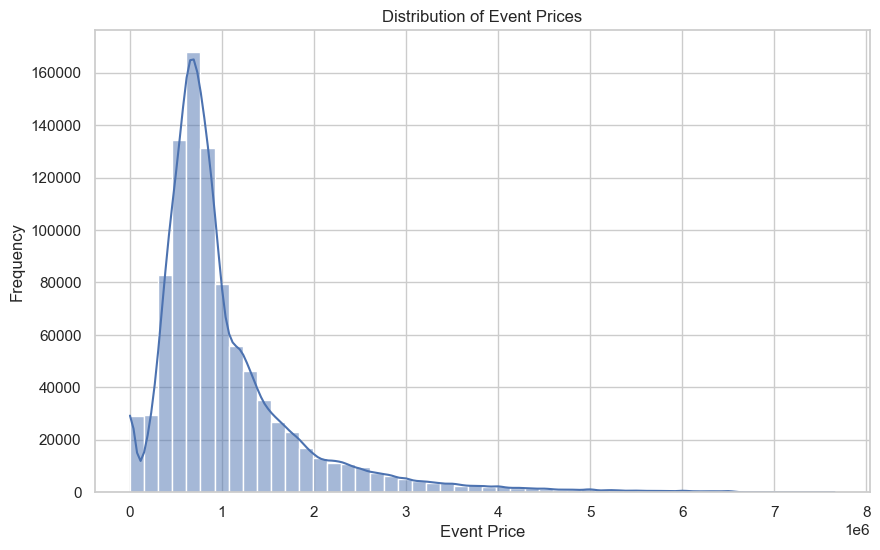

In [44]:
# Distribution of eventprice
plt.figure(figsize=(10, 6))
sns.histplot(df['eventprice'], bins=50, kde=True)
plt.title('Distribution of Event Prices')
plt.xlabel('Event Price')
plt.ylabel('Frequency')
plt.show()

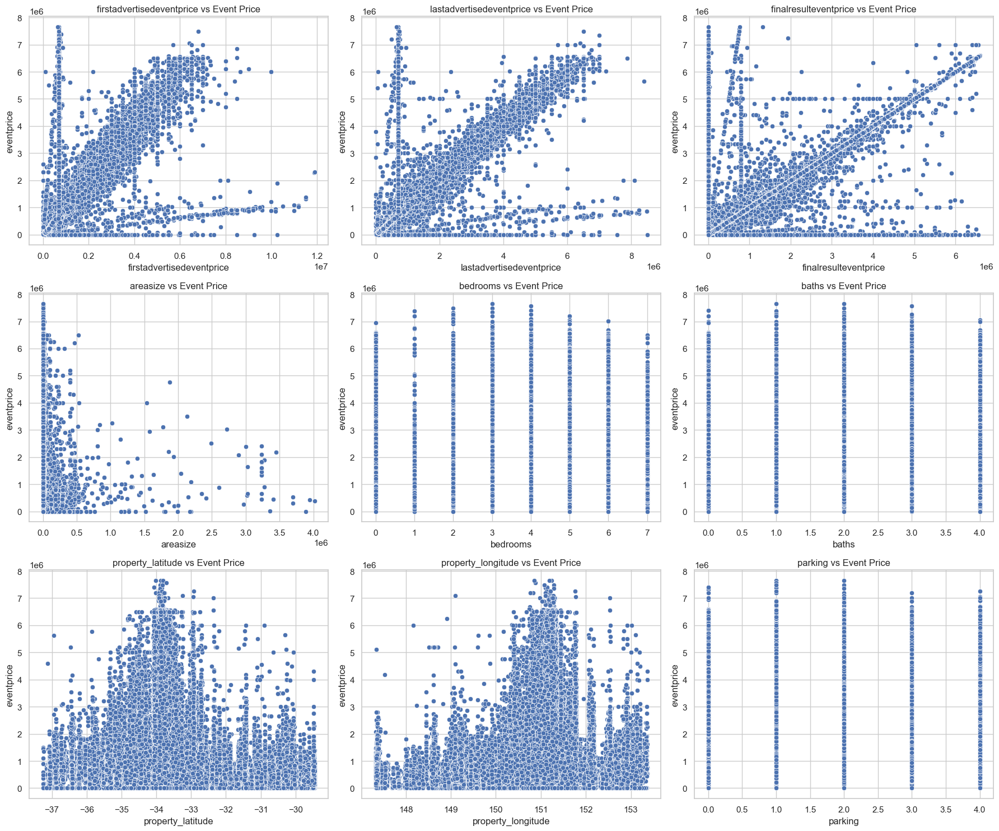

In [45]:
# Scatter plots for key relationships with eventprice
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(18, 15))
axes = axes.flatten()

variables = ['firstadvertisedeventprice', 'lastadvertisedeventprice', 
              'finalresulteventprice', 'areasize', 'bedrooms', 'baths', 
              'property_latitude', 'property_longitude', 'parking']

for i, var in enumerate(variables):
    sns.scatterplot(data=df, x=var, y='eventprice', ax=axes[i])
    axes[i].set_title(f'{var} vs Event Price')

plt.tight_layout()
plt.show()


Reasons for Removal
High Correlation with Target Variable:

Features: firstadvertisedeventprice, lastadvertisedeventprice, and finalresulteventprice are highly correlated with eventprice (correlation coefficients around 0.91 to 0.96).
Implication: These features are strongly related to the target variable and might lead to multicollinearity issues if included in the model. This can affect model performance and interpretability.
Overfitting Risk:

Features: Including highly correlated features can cause the model to overfit, as it might learn noise rather than generalizable patterns.
Implication: Overfitting results in a model that performs well on training data but poorly on unseen data.
Redundancy:

Features: Since these features are highly correlated with eventprice, they do not provide additional predictive power beyond what is already captured by eventprice itself.
Implication: Including redundant features can unnecessarily increase the complexity of the model without improving its performance.

# Model

## Prepare the data

In [46]:
# Define features and target variable
features = ['areasize', 'bedrooms', 'baths', 'property_latitude', 'property_longitude', 'parking']
target = 'eventprice'

# Prepare the data
X = df[features]
y = df[target]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [47]:
# Function to print model performance
def print_model_performance(model, X_test, y_test):
    y_pred = model.predict(X_test)
    print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_pred))
    print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_pred))
    print("Root Mean Squared Error (RMSE):", np.sqrt(mean_squared_error(y_test, y_pred)))
    print("R-squared:", r2_score(y_test, y_pred))

## Model 1: Linear Regression

In [48]:
# Initialize models
lr_model = LinearRegression()
rf_model = RandomForestRegressor(random_state=42)
gb_model = GradientBoostingRegressor(random_state=42)

# Train models
lr_model.fit(X_train, y_train)
rf_model.fit(X_train, y_train)
gb_model.fit(X_train, y_train)

# Predict on the test set
y_pred_lr = lr_model.predict(X_test)
y_pred_rf = rf_model.predict(X_test)
y_pred_gb = gb_model.predict(X_test)

In [49]:
# Evaluate models
print("Linear Regression:")
print("R^2:", r2_score(y_test, y_pred_lr))
print("MSE:", mean_squared_error(y_test, y_pred_lr))
print("\nRandom Forest:")
print("R^2:", r2_score(y_test, y_pred_rf))
print("MSE:", mean_squared_error(y_test, y_pred_rf))
print("\nGradient Boosting:")
print("R^2:", r2_score(y_test, y_pred_gb))
print("MSE:", mean_squared_error(y_test, y_pred_gb))

Linear Regression:
R^2: 0.16652199590732686
MSE: 570214410271.1593

Random Forest:
R^2: 0.777800275522511
MSE: 152015391207.92175

Gradient Boosting:
R^2: 0.5954307469243784
MSE: 276781411055.34064


In [50]:
# Set display option to avoid scientific notation
pd.set_option('display.float_format', lambda x: '%.2f' % x)

# Print 5 samples between the actual and predicted values for Linear Regression
lr_samples = pd.DataFrame({'Actual': y_test[:5], 'Predicted': y_pred_lr[:5]})
print("Linear Regression - Actual vs Predicted:")
print(lr_samples)

# Print 5 samples between the actual and predicted values for Random Forest
rf_samples = pd.DataFrame({'Actual': y_test[:5], 'Predicted': y_pred_rf[:5]})
print("\nRandom Forest - Actual vs Predicted:")
print(rf_samples)

# Print 5 samples between the actual and predicted values for Gradient Boosting
gb_samples = pd.DataFrame({'Actual': y_test[:5], 'Predicted': y_pred_gb[:5]})
print("\nGradient Boosting - Actual vs Predicted:")
print(gb_samples)

Linear Regression - Actual vs Predicted:
            Actual  Predicted
640366  1150000.00 1308328.42
1036521  450000.00 1131948.65
302917   550000.00  692942.85
224476  1360000.00 1240377.73
795830   801000.00 1356421.44

Random Forest - Actual vs Predicted:
            Actual  Predicted
640366  1150000.00  978376.26
1036521  450000.00  377712.32
302917   550000.00  604929.67
224476  1360000.00 1263810.00
795830   801000.00  659688.11

Gradient Boosting - Actual vs Predicted:
            Actual  Predicted
640366  1150000.00 1181724.19
1036521  450000.00  858042.43
302917   550000.00  726808.75
224476  1360000.00 1052985.16
795830   801000.00  715657.96


In [ ]:
# Define the parameter grid
param_grid = {
    'n_estimators': [100, 200, 300, 400, 500],
    'max_features': ['auto', 'sqrt'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# Initialize the model
rf = RandomForestRegressor(random_state=42)

# Set up the random search with cross-validation
rf_random = RandomizedSearchCV(estimator=rf, param_distributions=param_grid, 
                               n_iter=100, cv=3, verbose=2, random_state=42, 
                               n_jobs=-1)

# Fit the random search model
rf_random.fit(X_train, y_train)

# Print the best parameters
print("Best parameters found: ", rf_random.best_params_)

# Train the model with the best parameters
best_rf = rf_random.best_estimator_

# Make predictions on the test data
y_pred_rf_optimized = best_rf.predict(X_test)

# Evaluate the optimized model
from sklearn.metrics import r2_score, mean_squared_error

r2_optimized = r2_score(y_test, y_pred_rf_optimized)
mse_optimized = mean_squared_error(y_test, y_pred_rf_optimized)

print(f"Optimized Random Forest R^2: {r2_optimized}")
print(f"Optimized Random Forest MSE: {mse_optimized}")

# Print 5 samples between the actual and predicted values for the optimized model
rf_optimized_samples = pd.DataFrame({'Actual': y_test[:5], 'Predicted': y_pred_rf_optimized[:5]})
print("\nOptimized Random Forest - Actual vs Predicted:")
print(rf_optimized_samples)

Fitting 3 folds for each of 100 candidates, totalling 300 fits
